In [1]:
from fastai import *
from fastai.vision import *

In [2]:
path = Path('data/cycles')


In [3]:
classes = ['bike','unicycle','recumbent','walking','wheelchair']

In [4]:
np.random.seed(42)
data = ImageDataBunch.from_folder(path, train=".", valid_pct=0.2,
        ds_tfms=get_transforms(), size=224,  bs=8).normalize(imagenet_stats)

In [5]:
data.classes

['bike', 'walking', 'wheelchair', 'unicycle', 'recumbent']

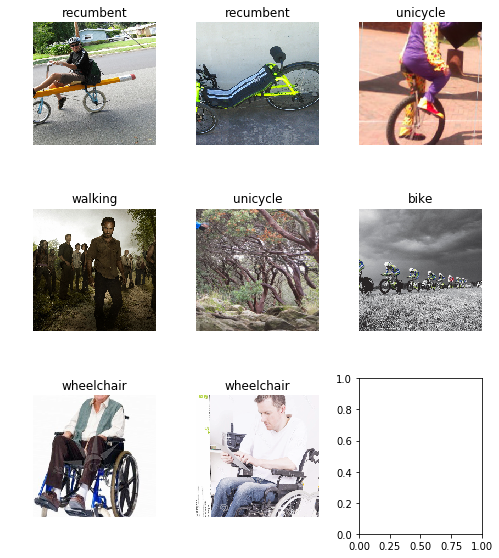

In [6]:
data.show_batch(rows=3, figsize=(7,8))

In [7]:
data.classes, data.c, len(data.train_ds), len(data.valid_ds)

(['bike', 'walking', 'wheelchair', 'unicycle', 'recumbent'], 5, 1185, 296)

## Train model

In [8]:
learn = create_cnn(data, models.resnet34, metrics=error_rate)

In [9]:
learn.fit_one_cycle(8)

Total time: 05:35
epoch  train_loss  valid_loss  error_rate
1      0.898772    0.378620    0.141892    (00:37)
2      0.694074    0.340484    0.145270    (00:40)
3      0.623813    0.305013    0.111486    (00:42)
4      0.607479    0.319420    0.121622    (00:44)
5      0.510892    0.267839    0.087838    (00:41)
6      0.374924    0.238011    0.084459    (00:42)
7      0.398264    0.201150    0.054054    (00:41)
8      0.349694    0.208293    0.067568    (00:44)



In [10]:
learn.load('stage-1-2')
#learn.save('stage-1-2')

ClassificationLearner(data=<fastai.vision.data.ImageDataBunch object at 0x7fb0c149ddd8>, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1

In [11]:
learn.unfreeze()

In [12]:
learn.lr_find()

LR Finder complete, type {learner_name}.recorder.plot() to see the graph.


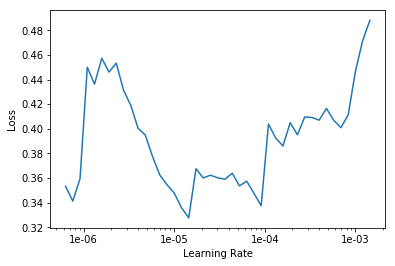

In [13]:
learn.recorder.plot()

In [14]:
learn.fit_one_cycle(10, max_lr=slice(1e-7,1e-6))

Total time: 07:37
epoch  train_loss  valid_loss  error_rate
1      0.325786    0.106588    0.033784    (00:45)
2      0.330445    0.109571    0.037162    (00:45)
3      0.374937    0.104948    0.027027    (00:47)
4      0.331459    0.098194    0.030405    (00:45)
5      0.340402    0.106838    0.043919    (00:46)
6      0.362201    0.101895    0.027027    (00:45)
7      0.378597    0.104742    0.033784    (00:46)
8      0.375125    0.102775    0.033784    (00:46)
9      0.432073    0.117334    0.037162    (00:44)
10     0.349282    0.108093    0.030405    (00:44)



In [15]:
learn.save('stage-2-2')

## Interpretation

In [16]:
learn.load('stage-2-2')

ClassificationLearner(data=<fastai.vision.data.ImageDataBunch object at 0x7fb0c149ddd8>, model=Sequential(
  (0): Sequential(
    (0): Conv2d(3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
    (1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
    (4): Sequential(
      (0): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
        (relu): ReLU(inplace)
        (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      )
      (1): BasicBlock(
        (conv1): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
        (bn1

In [17]:
interp = ClassificationInterpretation.from_learner(learn)

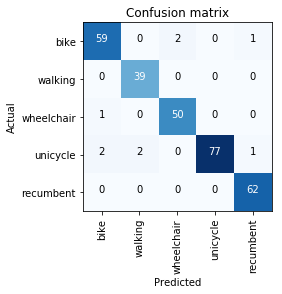

In [18]:
interp.plot_confusion_matrix()

## Cleaning Up

Some of our top losses aren't due to bad performance by our model. There are images in our data set that shouldn't be.

Using the `FileDeleter` widget from `fastai.widgets` we can prune our top losses, removing photos that don't belong.

First we need to get the file paths from our top_losses. Here's a handy function that pulls out all our top_losses:

In [19]:
from fastai.widgets import *

losses,idxs = interp.top_losses()
top_loss_paths = data.valid_ds.x[idxs]

Now we can pass in these paths to our widget.

In [20]:
fd = ImageDeleter(data, idxs)


Button(button_style='primary', description='Confirm', style=ButtonStyle())

Flag photos for deletion by clicking 'Delete'. Then click 'Confirm' to delete flagged photos and keep the rest in that row. The `File_Deleter` will show you a new row of images until there are no more to show. In this case, the widget will show you images until there are none left from `top_losses`.

## Putting your model in production

In [21]:
data.classes

['bike', 'walking', 'wheelchair', 'unicycle', 'recumbent']

You probably want to use CPU for inference, except at massive scale (and you almost certainly don't need to train in real-time). If you don't have a GPU that happens automatically. You can test your model on CPU like so:

In [22]:
#import blah
#test = blah.gui_fname()
#print(test)

In [23]:
# fastai.defaults.device = torch.device('cpu')

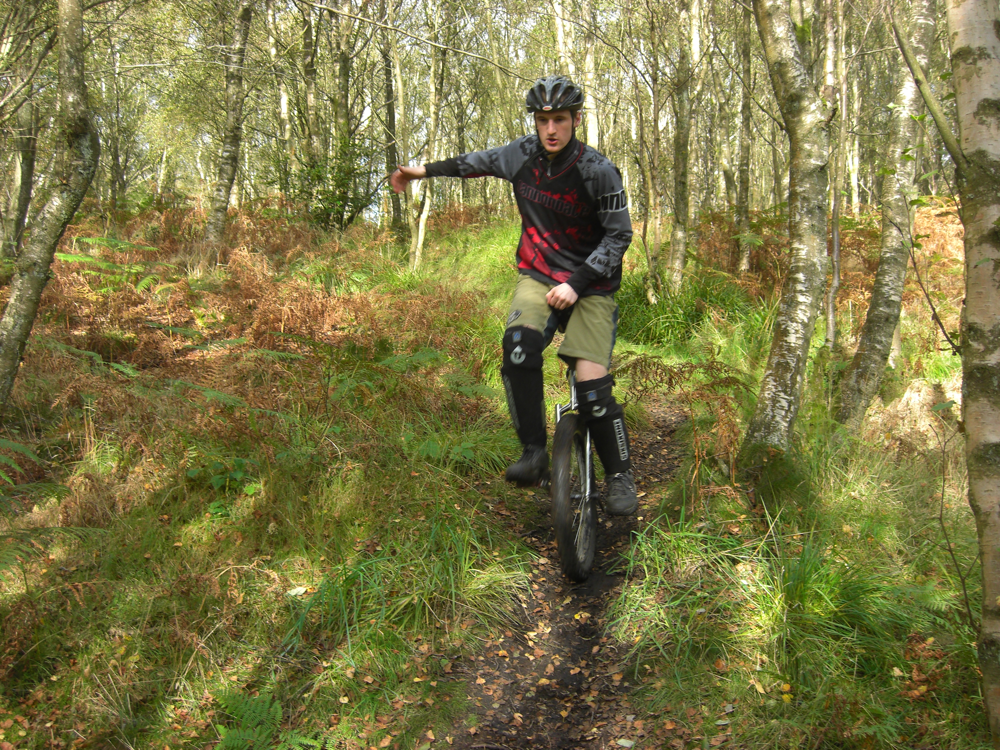

In [24]:
#img = open_image('/media/jj/Internal Storage 1/Pictures/IMG_3520_3.jpg')
#img = open_image('/media/jj/Internal Storage 1/Pictures/willJJuni.jpg')
#img = open_image('/media/jj/Internal Storage 1/Pictures/43862528894_91a5aa8901_o-min.jpg')
img = open_image('/media/jj/Internal Storage 1/Pictures/Photos/Unicycling in Milngavie/CIMG8213.JPG')
#img = open_image('/media/jj/Internal Storage 1/Pictures/Photos/Unicycling in Milngavie/CIMG8621.JPG')
img

In [25]:
pred_class,pred_idx,outputs = learn.predict(img)
pred_class

'unicycle'